### 1. Importing Libraries and the Dataset

In [1]:
import matplotlib.pyplot as plt
import matplotlib.lines as lines
import seaborn as sns
import numpy as np
import pandas as pd
import random

from scipy import stats
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [2]:
import keras
import tensorflow as tf
from pylab import rcParams
from sklearn.model_selection import train_test_split
from keras.models import Model, load_model, Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import backend as K
from keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping
from keras import regularizers

sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 14, 8

RANDOM_SEED = 42

Using TensorFlow backend.


In [3]:
cc_info = pd.read_csv('cc_info.csv')
cc_info.shape

(984, 5)

In [4]:
cc_info.head()

,credit_card,city,state,zipcode,credit_card_limit
0,1280981422329509,Dallas,PA,18612,6000
1,9737219864179988,Houston,PA,15342,16000
2,4749889059323202,Auburn,MA,1501,14000
3,9591503562024072,Orlando,WV,26412,18000
4,2095640259001271,New York,NY,10001,20000


In [5]:
txns = pd.read_csv('transactions.csv')
txns.shape

(294588, 5)

In [6]:
txns.head()

,credit_card,date,transaction_dollar_amount,Long,Lat
0,1003715054175576,2015-09-11 00:32:40,43.78,-80.174132,40.267370
1,1003715054175576,2015-10-24 22:23:08,103.15,-80.194240,40.180114
2,1003715054175576,2015-10-26 18:19:36,48.55,-80.211033,40.313004
3,1003715054175576,2015-10-22 19:41:10,136.18,-80.174138,40.290895
4,1003715054175576,2015-10-26 20:08:22,71.82,-80.238720,40.166719


### 2. Data Preparation

In [7]:
cc_txns = pd.merge(txns, cc_info, how='left', left_on='credit_card', right_on='credit_card')
print(cc_txns.shape)
cc_txns.head()

(294588, 9)


,credit_card,date,transaction_dollar_amount,Long,Lat,city,state,zipcode,credit_card_limit
0,1003715054175576,2015-09-11 00:32:40,43.78,-80.174132,40.267370,Houston,PA,15342,20000
1,1003715054175576,2015-10-24 22:23:08,103.15,-80.194240,40.180114,Houston,PA,15342,20000
2,1003715054175576,2015-10-26 18:19:36,48.55,-80.211033,40.313004,Houston,PA,15342,20000
3,1003715054175576,2015-10-22 19:41:10,136.18,-80.174138,40.290895,Houston,PA,15342,20000
4,1003715054175576,2015-10-26 20:08:22,71.82,-80.238720,40.166719,Houston,PA,15342,20000


In [8]:
cc_txns.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 294588 entries, 0 to 294587
Data columns (total 9 columns):
credit_card                  294588 non-null int64
date                         294588 non-null object
transaction_dollar_amount    294588 non-null float64
Long                         294588 non-null float64
Lat                          294588 non-null float64
city                         294588 non-null object
state                        294588 non-null object
zipcode                      294588 non-null int64
credit_card_limit            294588 non-null int64
dtypes: float64(3), int64(3), object(3)
memory usage: 22.5+ MB


In [9]:
# check null values in each column
cc_txns.isnull().sum()

credit_card                  0
date                         0
transaction_dollar_amount    0
Long                         0
Lat                          0
city                         0
state                        0
zipcode                      0
credit_card_limit            0
dtype: int64

In [10]:
# describing numberic variables and checking variance among them
cc_txns.describe(include='all')

,credit_card,date,transaction_dollar_amount,Long,Lat,city,state,zipcode,credit_card_limit
count,2.945880e+05,294588,294588.000000,294588.000000,294588.000000,294588,294588,294588.000000,294588.000000
unique,NaN,281065,NaN,NaN,NaN,124,35,NaN,NaN
top,NaN,2015-08-13 21:18:33,NaN,NaN,NaN,Washington,NH,NaN,NaN
freq,NaN,4,NaN,NaN,NaN,112693,118247,NaN,NaN
mean,5.424562e+15,NaN,86.008036,-76.235238,40.937669,NaN,NaN,18073.772516,15502.053716
std,2.555803e+15,NaN,124.655954,20.135015,5.391695,NaN,NaN,23945.510551,7956.291556
min,1.003715e+15,NaN,0.010000,-179.392887,-68.046553,NaN,NaN,690.000000,2000.000000
25%,3.344214e+15,NaN,29.970000,-80.209708,40.487726,NaN,NaN,3280.000000,10000.000000
50%,5.353426e+15,NaN,58.470000,-73.199737,42.403066,NaN,NaN,5820.000000,15000.000000
75%,7.646245e+15,NaN,100.400000,-72.091933,43.180015,NaN,NaN,18612.000000,20000.000000


In [11]:
# checking how Latitude & Longitude variables relates with City variable
pv = pd.pivot_table(cc_txns, values=['credit_card_limit'] ,columns=['city','Lat','Long'],aggfunc=('count'),fill_value=0)
pv

                   city              Lat         Long       
credit_card_limit  Akron             -18.917656  -13.527153     1
                                     -4.755322    75.986494     1
                                      5.336843    0.156982      1
                                      9.878285    65.204080     1
                                      14.137147   127.691074    1
                                      16.646398   103.207154    1
                                      21.664606  -159.795578    1
                                      26.977873   125.274188    1
                                      28.554060   85.361699     1
                                      30.555095   164.291577    1
                                      32.838950   120.493646    1
                                      35.483361   23.486453     1
                                      35.904809   32.805253     1
                                      36.809885   18.991224     1
               

In [12]:
# confirming if city and zipcode have 1-to-1 mapping
pv = pd.pivot_table(cc_txns, values=['credit_card_limit'] ,columns=['state','city','zipcode'],aggfunc=('count'),fill_value=0)
pv

                   state  city              zipcode
credit_card_limit  AL     Huntsville        35801         591
                          Mobile            36601         798
                   AZ     Tucson            85701         619
                   CA     Los Angeles       90001        2310
                          San Francisco     94101        2608
                          Vallejo           94589          36
                   CO     Colorado Springs  80509         532
                   CT     Columbia          6237         1272
                   FL     Fort Lauderdale   33301         279
                          Pensacola         32501         410
                          Tampa             33601         923
                   GA     Louisville        30434        2752
                          Omaha             31821         281
                          Quitman           31643         584
                   HI     Honolulu          96801         839
                  

In [13]:
# as city and zipcode are 100% correlated, dropping column city and keeping zipcode because of its numeric values
cc_txns1 = cc_txns.drop(columns=['city'], axis=1)
cc_txns1.columns

Index(['credit_card', 'date', 'transaction_dollar_amount', 'Long', 'Lat',
       'state', 'zipcode', 'credit_card_limit'],
      dtype='object')

In [14]:
cc_txns1['date'] = pd.to_datetime(cc_txns1['date'], 
 format = '%Y-%m-%d %H:%M:%S')
cc_txns1.head()

,credit_card,date,transaction_dollar_amount,Long,Lat,state,zipcode,credit_card_limit
0,1003715054175576,2015-09-11 00:32:40,43.78,-80.174132,40.267370,PA,15342,20000
1,1003715054175576,2015-10-24 22:23:08,103.15,-80.194240,40.180114,PA,15342,20000
2,1003715054175576,2015-10-26 18:19:36,48.55,-80.211033,40.313004,PA,15342,20000
3,1003715054175576,2015-10-22 19:41:10,136.18,-80.174138,40.290895,PA,15342,20000
4,1003715054175576,2015-10-26 20:08:22,71.82,-80.238720,40.166719,PA,15342,20000


In [15]:
# The date variable is split into day, month, hour, minute & second variabales for better usability in model
cc_txns1['date_month'] = cc_txns1['date'].dt.month
cc_txns1['date_day'] = cc_txns1['date'].dt.day
cc_txns1['date_hour'] = cc_txns1['date'].dt.hour
cc_txns1['date_minute'] = cc_txns1['date'].dt.minute
cc_txns1['date_second'] = cc_txns1['date'].dt.second
cc_txns1['date_dayofweek'] = cc_txns1['date'].dt.dayofweek
cc_txns1.head()

,credit_card,date,transaction_dollar_amount,Long,Lat,state,zipcode,credit_card_limit,date_month,date_day,date_hour,date_minute,date_second,date_dayofweek
0,1003715054175576,2015-09-11 00:32:40,43.78,-80.174132,40.267370,PA,15342,20000,9,11,0,32,40,4
1,1003715054175576,2015-10-24 22:23:08,103.15,-80.194240,40.180114,PA,15342,20000,10,24,22,23,8,5
2,1003715054175576,2015-10-26 18:19:36,48.55,-80.211033,40.313004,PA,15342,20000,10,26,18,19,36,0
3,1003715054175576,2015-10-22 19:41:10,136.18,-80.174138,40.290895,PA,15342,20000,10,22,19,41,10,3
4,1003715054175576,2015-10-26 20:08:22,71.82,-80.238720,40.166719,PA,15342,20000,10,26,20,8,22,0


In [16]:
# Removing the original date variable
cc_txns1 = cc_txns1.drop(columns=['date'], axis=1)
cc_txns1.columns


Index(['credit_card', 'transaction_dollar_amount', 'Long', 'Lat', 'state',
       'zipcode', 'credit_card_limit', 'date_month', 'date_day', 'date_hour',
       'date_minute', 'date_second', 'date_dayofweek'],
      dtype='object')

In [17]:
# Creating dummy variables for State variable to convert it to numeric variable
cc_txns1 = pd.get_dummies(cc_txns1,columns=['state'])
print(cc_txns1.columns)
cc_txns1.head()

Index(['credit_card', 'transaction_dollar_amount', 'Long', 'Lat', 'zipcode',
       'credit_card_limit', 'date_month', 'date_day', 'date_hour',
       'date_minute', 'date_second', 'date_dayofweek', 'state_AL', 'state_AZ',
       'state_CA', 'state_CO', 'state_CT', 'state_FL', 'state_GA', 'state_HI',
       'state_IA', 'state_ID', 'state_IL', 'state_IN', 'state_KS', 'state_LA',
       'state_MA', 'state_MD', 'state_ME', 'state_MI', 'state_MO', 'state_NC',
       'state_NH', 'state_NJ', 'state_NM', 'state_NY', 'state_OH', 'state_OK',
       'state_PA', 'state_PR', 'state_RI', 'state_TX', 'state_UT', 'state_VA',
       'state_VT', 'state_WA', 'state_WV'],
      dtype='object')


,credit_card,transaction_dollar_amount,Long,Lat,zipcode,credit_card_limit,date_month,date_day,date_hour,date_minute,date_second,date_dayofweek,state_AL,state_AZ,state_CA,state_CO,state_CT,state_FL,state_GA,state_HI,state_IA,state_ID,state_IL,state_IN,state_KS,state_LA,state_MA,state_MD,state_ME,state_MI,state_MO,state_NC,state_NH,state_NJ,state_NM,state_NY,state_OH,state_OK,state_PA,state_PR,state_RI,state_TX,state_UT,state_VA,state_VT,state_WA,state_WV
0,1003715054175576,43.78,-80.174132,40.267370,15342,20000,9,11,0,32,40,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,1003715054175576,103.15,-80.194240,40.180114,15342,20000,10,24,22,23,8,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
2,1003715054175576,48.55,-80.211033,40.313004,15342,20000,10,26,18,19,36,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
3,1003715054175576,136.18,-80.174138,40.290895,15342,20000,10,22,19,41,10,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
4,1003715054175576,71.82,-80.238720,40.166719,15342,20000,10,26,20,8,22,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0


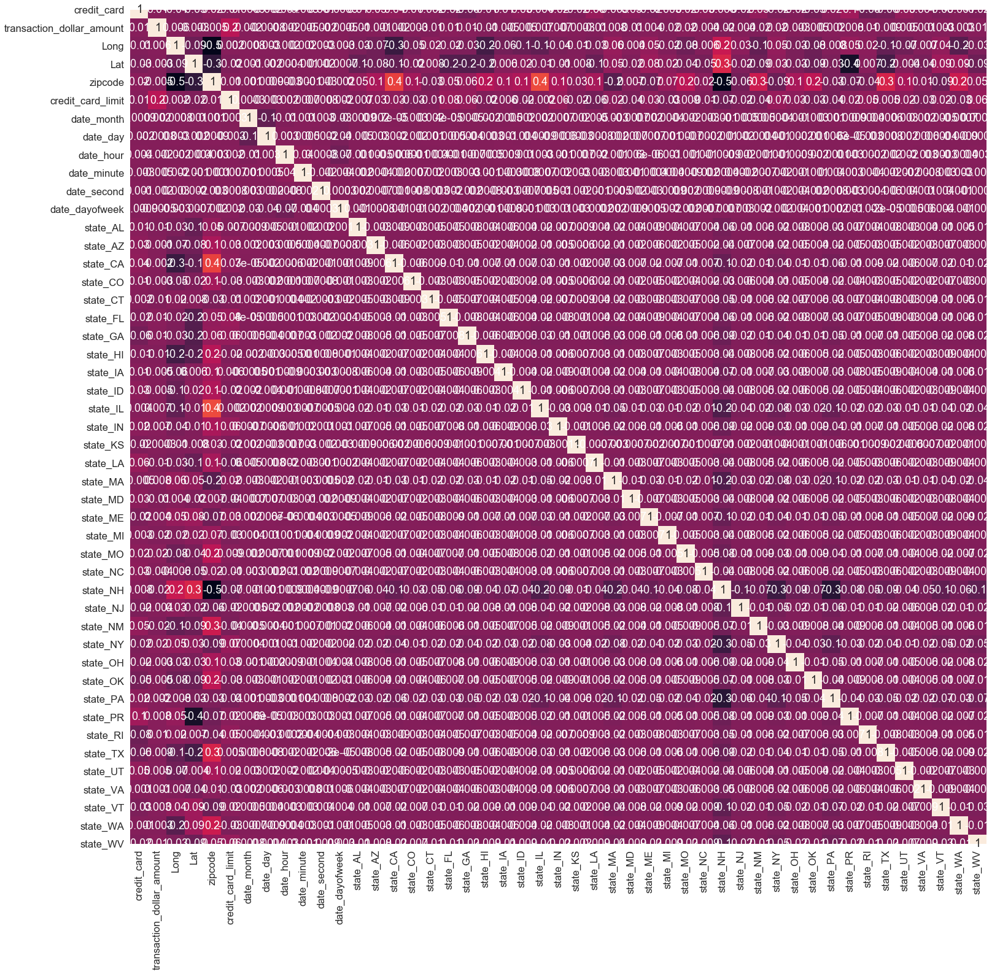

In [18]:
#plotting correlation matrix for all variables
plt.figure(figsize = (25, 25))
sns.heatmap(cc_txns1.corr(),  cbar=False, fmt='.1g', annot = True)
plt.show()

### Building & training the Model

As we do not have the target variable in this data, Autoencoder using Keras would be the best model to use for this problem. Autoencoders usually take the input data and recreate the same in form of Output, using the training. Error is then calculated between input and output i.e, Actual and predicted values. As this is unsupervised approach, so training data and test/validation data will be same. 


**Model Architecture -**

Encoder part uses input layer with 20 units using relu activation function, followed by a dropout of 0.1, then dense layers of 10 and 5 units with relu activation fuunction. Decoder part is then added in sequence which uses dense layers of 10, 20 units with relu activation function, followed by dropout of 0.1, and output layer with sigmoid activation function

In [20]:
from sklearn import preprocessing
# transforming the data using MinMaxScaler to bring all values on same scale.
scaler = preprocessing.MinMaxScaler()
scaler.fit(cc_txns1)

scaled_data = scaler.transform(cc_txns1)



n_features = cc_txns1.shape[1] # input shape

# Building Autoencoder model
# Model Input layer adn Output Layer of size same as number of features in data 
encoder = Sequential(name='encoder')
encoder.add(layer=Dense(20, activation='relu', input_shape=[n_features])) 
encoder.add(Dropout(0.1))
encoder.add(layer=Dense(10, activation='relu'))
encoder.add(layer=Dense(5, activation='relu'))

decoder = Sequential(name='decoder')
decoder.add(layer=Dense(10, activation='relu', input_shape=[5]))
decoder.add(layer=Dense(20, activation='relu'))
decoder.add(Dropout(0.1))
decoder.add(layer=Dense(n_features, activation='sigmoid'))

autoencoder = Sequential([encoder, decoder])

#compiling the autoencoder
# loss function used is Mean Squared Error(MSE), optimizer is adam and metric is MSE
autoencoder.compile(loss=keras.losses.MSE, optimizer='adam', metrics=[keras.metrics.mean_squared_error])

es = EarlyStopping(monitor='val_loss', min_delta=0.00001, patience=20, restore_best_weights=True)

# Train the model
history = autoencoder.fit(x=scaled_data, y=scaled_data, epochs=60, verbose=1, 
                          validation_data=[scaled_data, scaled_data], callbacks=[es])

Train on 294588 samples, validate on 294588 samples
Epoch 1/60
294588/294588 [==============================] - 34s 115us/step - loss: 0.0184 - mean_squared_error: 0.0184 - val_loss: 0.0115 - val_mean_squared_error: 0.0115
Epoch 2/60
294588/294588 [==============================] - 33s 113us/step - loss: 0.0127 - mean_squared_error: 0.0127 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 3/60
294588/294588 [==============================] - 33s 111us/step - loss: 0.0117 - mean_squared_error: 0.0117 - val_loss: 0.0092 - val_mean_squared_error: 0.0092
Epoch 4/60
294588/294588 [==============================] - 34s 115us/step - loss: 0.0113 - mean_squared_error: 0.0113 - val_loss: 0.0089 - val_mean_squared_error: 0.0089
Epoch 5/60
294588/294588 [==============================] - 33s 111us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0088 - val_mean_squared_error: 0.0088
Epoch 6/60
294588/294588 [==============================] - 33s 111us/step - loss: 0.0107 - m

Model was run on entire data of 294,588 samples, for 60 epochs. The training & Validation loss started converging after 56th epoch

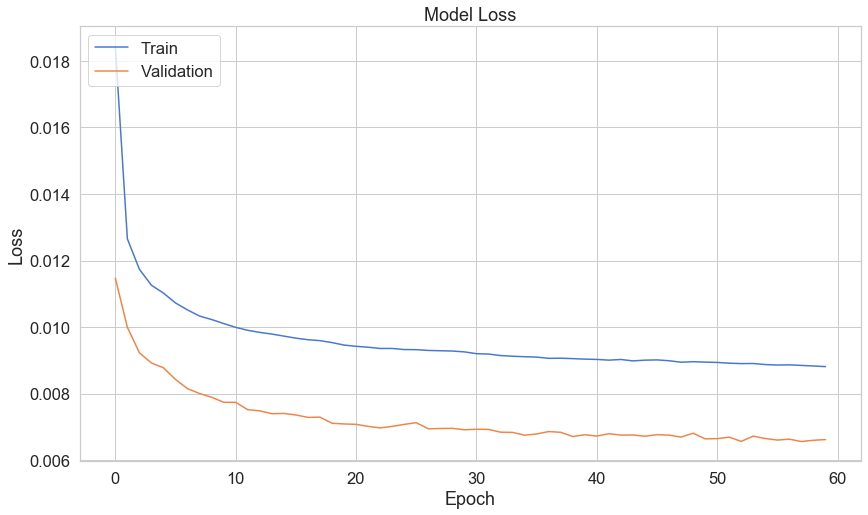

In [21]:
# Plotting the loss for Training data and Validation Data
plt.plot(history.history['loss']) 
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [22]:
# Setting the threshold for frauds to 95th percentile of MSE
train_predicted_x = autoencoder.predict(x=scaled_data)
train_events_mse = keras.losses.mean_squared_error(scaled_data, train_predicted_x)
cut_off = np.percentile(train_events_mse, 95)
print(cut_off)

0.019076134357601388


The threshold is 0.019. Any transaction which has MSE > 0.019 will be considered as potential fraudulent transaction.

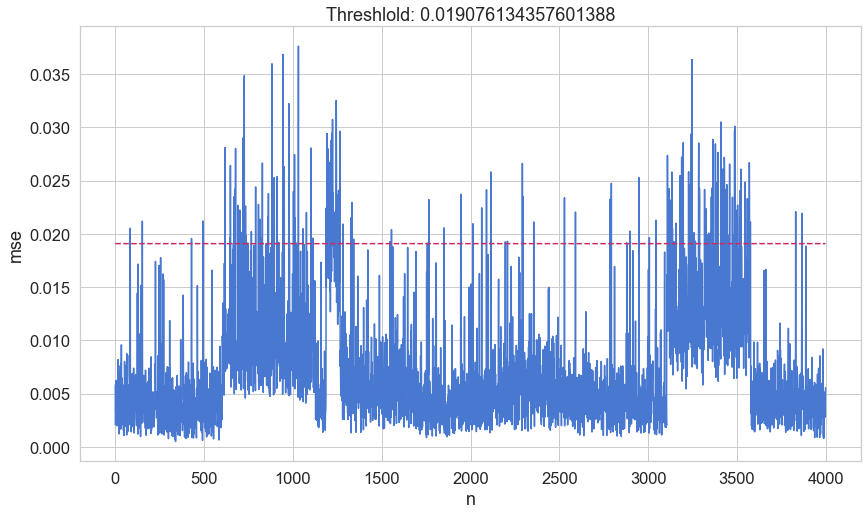

In [23]:
# visualizing the loss on sample data of 4000 transactions
plot_samples = 4000


real_x = scaled_data[:plot_samples].reshape(plot_samples, n_features)
predicted_x = autoencoder.predict(x=real_x)
events_mse = keras.losses.mean_squared_error(real_x, predicted_x)
events_df = pd.DataFrame({
    'mse': events_mse,
    'n': np.arange(0, plot_samples)})



plot = sns.lineplot(x=events_df.n, y=events_df.mse)

line = lines.Line2D(
    xdata=np.arange(0, plot_samples),
    ydata=np.full(plot_samples, cut_off),
    color='#CC2B5E',
    linewidth=1.5,
    linestyle='dashed')

plot.add_artist(line)
plt.title('Threshlold: {threshold}'.format(threshold=cut_off))
plt.show()

In [27]:
results_df = cc_txns.merge(events_df, left_index=True, right_index=True)
results_df.head()

,credit_card,date,transaction_dollar_amount,Long,Lat,city,state,zipcode,credit_card_limit,mse,n
0,1003715054175576,2015-09-11 00:32:40,43.78,-80.174132,40.267370,Houston,PA,15342,20000,0.002067,0
1,1003715054175576,2015-10-24 22:23:08,103.15,-80.194240,40.180114,Houston,PA,15342,20000,0.005846,1
2,1003715054175576,2015-10-26 18:19:36,48.55,-80.211033,40.313004,Houston,PA,15342,20000,0.003232,2
3,1003715054175576,2015-10-22 19:41:10,136.18,-80.174138,40.290895,Houston,PA,15342,20000,0.004817,3
4,1003715054175576,2015-10-26 20:08:22,71.82,-80.238720,40.166719,Houston,PA,15342,20000,0.004740,4


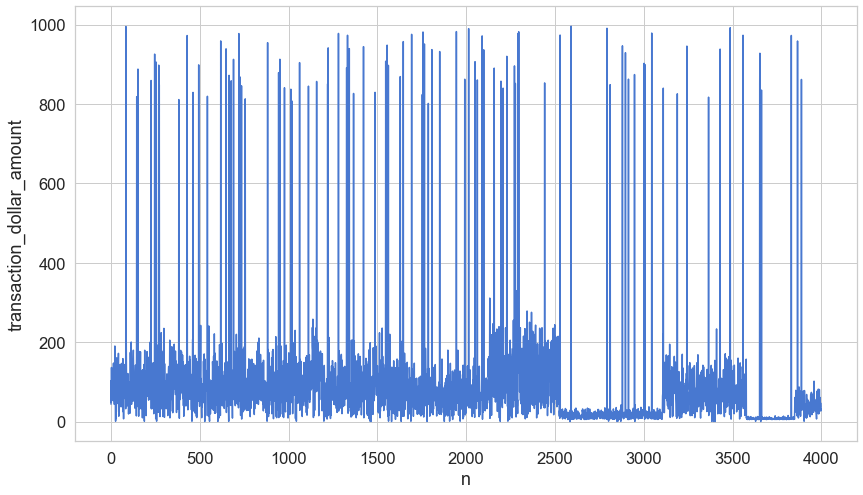

In [28]:
plot = sns.lineplot(x=results_df.n, y=results_df.transaction_dollar_amount)

The above plot shows that most of the transactions have smaller amount and few are high value transactions

In [29]:
#Filter dataset for potential frauds if MSE is greater than cut-off threshold
potential_fraud = results_df[(results_df['mse']>cut_off)]
potential_fraud.shape

(184, 11)

potential_fraud dataset returns 184 transactions which are potentially fraudulent and needs investigation.

In [32]:
potential_fraud.head(5)

,credit_card,date,transaction_dollar_amount,Long,Lat,city,state,zipcode,credit_card_limit,mse,n
84,1003715054175576,2015-09-11 19:50:02,995.35,-80.126760,40.225626,Houston,PA,15342,20000,0.020523,84
152,1003715054175576,2015-10-18 01:01:41,888.04,-80.231908,40.297183,Houston,PA,15342,20000,0.021186,152
429,1013870087888817,2015-08-19 19:12:24,972.63,-72.067729,43.119872,Washington,NH,3280,15000,0.019549,429
494,1013870087888817,2015-10-24 20:00:27,898.64,-72.029790,43.152884,Washington,NH,3280,15000,0.021206,494
618,1023820165155391,2015-09-26 22:59:10,959.00,-73.280564,44.343771,Charlotte,VT,5445,28000,0.028092,618


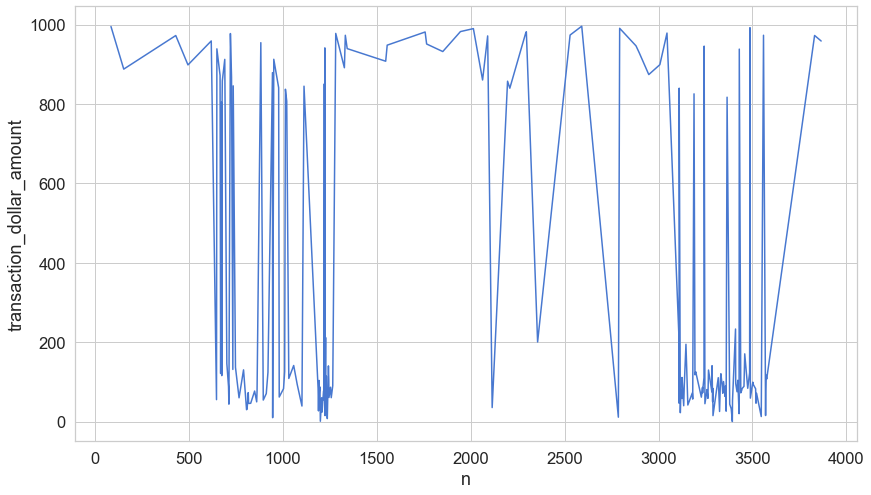

In [31]:
plot = sns.lineplot(x=potential_fraud.n, y=potential_fraud.transaction_dollar_amount)

The above plot shows the amount of potentially fraudulent transactions, most of which are high value transactions